In [1]:
from IPython.display import Image

In [2]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML


manualSeed = 999

print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [3]:
# Кол-во эпох
num_epochs = 5
# Инициализация Weights & Biases
import wandb
wandb.init(project="symphonicmasks-org", entity="topalidia")
wandb.config = {
  "learning_rate": 0.0002,
  "epochs": num_epochs,
  "batch_size": 16
}

wandb: Currently logged in as: topalidia. Use `wandb login --relogin` to force relogin


In [4]:
dataroot = "/kaggle/input/celeba-dataset/img_align_celeba"
workers = 2
batch_size = 128*2
image_size = 64
nc = 3
nz = 100
ngf = 64
lr = 0.0002
beta1 = 0.5
ngpu = 1

/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


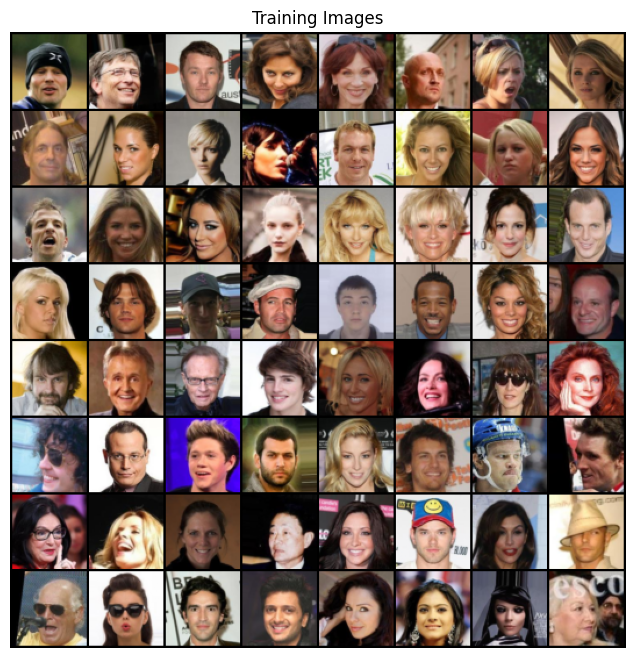

In [5]:
# Для создания датасета используем класс ImageFolder
# Создаем датасет
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Создаем даталоадер
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Выбираем девайс для вычислений
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Нарисуем часть картинок из датасета
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [6]:
# кастомная инициализация весов netG или netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [18]:
class CSPUpBlock(nn.Module):
    def __init__(self, in_channels, out_channels, middle_channels):
        super(CSPUpBlock, self).__init__()

        self.conv1 = nn.Sequential(
            
            nn.ConvTranspose2d(in_channels, middle_channels, 4, 2, 1, bias=False),
            nn.BatchNorm2d(middle_channels),
            nn.ReLU(True)
        )

        self.conv2 = nn.Sequential(
            # Этот слой сохраняет размер, но изменяет количество каналов
            nn.Conv2d(middle_channels, out_channels, 3, 1, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(True)
        )

        self.conv3 = nn.Sequential(
            # Этот слой сохраняет исходный размер и количество каналов
            nn.Conv2d(in_channels, middle_channels, 3, 1, 1, bias=False),
            nn.BatchNorm2d(middle_channels),
            nn.ReLU(True),
            
            nn.Conv2d(middle_channels, out_channels, 3, 1, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(True)
        )

    def forward(self, x):
        x1 = self.conv1(x)
        x1 = self.conv2(x1)  # После этого x1 имеет out_channels и увеличенный размер

        x2 = self.conv3(x)  # После этого x2 имеет out_channels и оригинальный размер

        
    
        x2_upsampled = torch.nn.functional.interpolate(x2, size=x1.size()[2:], mode='nearest')  # Подгонка размера x2 под x1

        out = x1 + x2_upsampled  # Теперь x1 и x2_upsampled имеют одинаковые размеры и могут быть сложены
        return out



In [50]:
import torch.optim as optim
import torchvision.utils as vutils

# Определение генератора
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        nz = 100  # Размерность латентного пространства
        ngf = 64  # Глубина фильтров в первом сверточном слое генератора
        nc = 3    # Количество каналов в изображении 
        # Определение архитектуры генератора
        self.main = nn.Sequential(
            # Входные данные Z идут в сверточный слой
            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # Размер: (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # Размер: (ngf*4) x 8 x 8
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # Размер: (ngf*2) x 16 x 16
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # Размер: (ngf) x 32 x 32
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # Итоговый размер: (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)


In [51]:
# Инициализируем генератор
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Инициализируем веса
netG.apply(weights_init)

print(netG)


Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [52]:
# Определение дискриминатора
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        ndf = 64  # Глубина фильтров в первом сверточном слое дискриминатора
        nc = 3    # Количество каналов в изображении
        # Определение архитектуры дискриминатора
        self.main = nn.Sequential(
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        output = self.main(input)
        return output.view(-1)  # Исправлено: Используем .view(-1) для приведения выхода к одномерному тензору


In [53]:
# инициализируем дискриминатор
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Инициализируем веса
netD.apply(weights_init)

print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [54]:
# Инициализируем лосс
criterion = nn.BCELoss()

# Создаем батч с рандомным шумом для генерации
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Метки для реальных данных и фековых
real_label = 1.
fake_label = 0.

# Устанавливаем оптимизаторы для G и D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [55]:
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# Для каждой эпохиfor epoch in range(num_epochs):
for epoch in range(num_epochs):
    # Для каждого батча в загрузчике данных
    for i, data in enumerate(dataloader, 0):

        ###########################
        # (1) Обучаем дискриминатор на реальных данных
        ###########################
        netD.zero_grad()
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        output = netD(real_cpu).squeeze()  
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        ###########################
        # (2) Обучаем дискриминатор на фейковых данных
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(fake_label)
        output_fake = netD(fake.detach()).view(-1)  # Исправлено: используем .view(-1) для соответствия размеру меток
        errD_fake = criterion(output_fake, label)
        errD_fake.backward()
        D_G_z1 = output_fake.mean().item()
        errD = errD_real + errD_fake
        optimizerD.step()

           

        ###########################
        # (3) Обучаем генератор
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # Метки для генератора
        output = netD(fake).squeeze() 
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()

        # Выводим статистику обучения
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Сохраняем потери для графиков
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Проверяем, как генератор прогрессирует, создавая фейковые изображения
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
        # Выводим статистику обучения
        if i % 50 == 0:
            log_dict = {
                'Loss_D': errD.item(),
                'Loss_G': errG.item(),
                'D(x)': D_x,
                'D(G(z))_real': D_G_z1,  # Среднее значение вероятности, что реальные данные распознаны как реальные
                'D(G(z))_fake': D_G_z2,  # Среднее значение вероятности, что фейковые данные распознаны как реальные
            }
            wandb.log(log_dict)
        
        # Дополнительное логирование и сохранение изображений
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            # Логируем изображения в wandb
            wandb.log({"examples": [wandb.Image(i) for i in img_list]})

        iters += 1


Starting Training Loop...
[0/5][0/792]	Loss_D: 1.7837	Loss_G: 6.2192	D(x): 0.7367	D(G(z)): 0.6972 / 0.0034
[0/5][50/792]	Loss_D: 0.3182	Loss_G: 25.6153	D(x): 0.8516	D(G(z)): 0.0000 / 0.0000
[0/5][100/792]	Loss_D: 0.5167	Loss_G: 5.2499	D(x): 0.7633	D(G(z)): 0.0325 / 0.0123
[0/5][150/792]	Loss_D: 1.6902	Loss_G: 2.0954	D(x): 0.3426	D(G(z)): 0.0139 / 0.1632
[0/5][200/792]	Loss_D: 0.7948	Loss_G: 2.6279	D(x): 0.6122	D(G(z)): 0.0838 / 0.0997
[0/5][250/792]	Loss_D: 0.5414	Loss_G: 5.7930	D(x): 0.8818	D(G(z)): 0.2638 / 0.0066
[0/5][300/792]	Loss_D: 0.4651	Loss_G: 3.0692	D(x): 0.7581	D(G(z)): 0.0949 / 0.0879
[0/5][350/792]	Loss_D: 0.3690	Loss_G: 5.3661	D(x): 0.9412	D(G(z)): 0.2372 / 0.0111
[0/5][400/792]	Loss_D: 0.6403	Loss_G: 4.1926	D(x): 0.8843	D(G(z)): 0.3455 / 0.0285
[0/5][450/792]	Loss_D: 0.8738	Loss_G: 2.9881	D(x): 0.6212	D(G(z)): 0.1531 / 0.0905
[0/5][500/792]	Loss_D: 0.3806	Loss_G: 3.9391	D(x): 0.8325	D(G(z)): 0.1393 / 0.0342
[0/5][550/792]	Loss_D: 0.9681	Loss_G: 2.0286	D(x): 0.5151	D(G(z

/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[1/5][0/792]	Loss_D: 1.1827	Loss_G: 5.0968	D(x): 0.4290	D(G(z)): 0.0030 / 0.0171
[1/5][50/792]	Loss_D: 0.3843	Loss_G: 4.0835	D(x): 0.8225	D(G(z)): 0.1343 / 0.0238
[1/5][100/792]	Loss_D: 0.3718	Loss_G: 5.1685	D(x): 0.8564	D(G(z)): 0.1372 / 0.0145
[1/5][150/792]	Loss_D: 1.3297	Loss_G: 1.3621	D(x): 0.3807	D(G(z)): 0.0193 / 0.3592
[1/5][200/792]	Loss_D: 0.4135	Loss_G: 4.8962	D(x): 0.7714	D(G(z)): 0.0510 / 0.0191
[1/5][250/792]	Loss_D: 0.5501	Loss_G: 3.7415	D(x): 0.7908	D(G(z)): 0.1974 / 0.0369
[1/5][300/792]	Loss_D: 0.5242	Loss_G: 3.1089	D(x): 0.7329	D(G(z)): 0.1138 / 0.0722
[1/5][350/792]	Loss_D: 0.6126	Loss_G: 2.8836	D(x): 0.7024	D(G(z)): 0.1096 / 0.0973
[1/5][400/792]	Loss_D: 0.9132	Loss_G: 6.6241	D(x): 0.9172	D(G(z)): 0.4717 / 0.0036
[1/5][450/792]	Loss_D: 0.4923	Loss_G: 3.8105	D(x): 0.8060	D(G(z)): 0.1944 / 0.0340
[1/5][500/792]	Loss_D: 0.3859	Loss_G: 3.5259	D(x): 0.8722	D(G(z)): 0.1849 / 0.0482
[1/5][550/792]	Loss_D: 0.9450	Loss_G: 3.2345	D(x): 0.5093	D(G(z)): 0.0175 / 0.0735
[1/5][6

/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[2/5][0/792]	Loss_D: 0.3730	Loss_G: 3.6883	D(x): 0.8642	D(G(z)): 0.1704 / 0.0372
[2/5][50/792]	Loss_D: 0.5365	Loss_G: 3.9474	D(x): 0.8355	D(G(z)): 0.2482 / 0.0294
[2/5][100/792]	Loss_D: 0.7139	Loss_G: 2.9201	D(x): 0.7027	D(G(z)): 0.2095 / 0.0905
[2/5][150/792]	Loss_D: 0.3751	Loss_G: 3.9489	D(x): 0.8779	D(G(z)): 0.1850 / 0.0304
[2/5][200/792]	Loss_D: 0.5034	Loss_G: 3.8250	D(x): 0.8449	D(G(z)): 0.2421 / 0.0360
[2/5][250/792]	Loss_D: 1.8241	Loss_G: 0.9316	D(x): 0.2798	D(G(z)): 0.0063 / 0.4589
[2/5][300/792]	Loss_D: 0.5020	Loss_G: 2.4446	D(x): 0.7464	D(G(z)): 0.1320 / 0.1293
[2/5][350/792]	Loss_D: 0.7465	Loss_G: 3.5360	D(x): 0.8051	D(G(z)): 0.3330 / 0.0530
[2/5][400/792]	Loss_D: 0.5252	Loss_G: 2.0463	D(x): 0.7113	D(G(z)): 0.0873 / 0.1805
[2/5][450/792]	Loss_D: 0.6489	Loss_G: 2.0082	D(x): 0.6173	D(G(z)): 0.0387 / 0.1953
[2/5][500/792]	Loss_D: 0.4476	Loss_G: 2.9796	D(x): 0.7825	D(G(z)): 0.1405 / 0.0756
[2/5][550/792]	Loss_D: 3.3243	Loss_G: 8.2114	D(x): 0.9844	D(G(z)): 0.9256 / 0.0012
[2/5][6

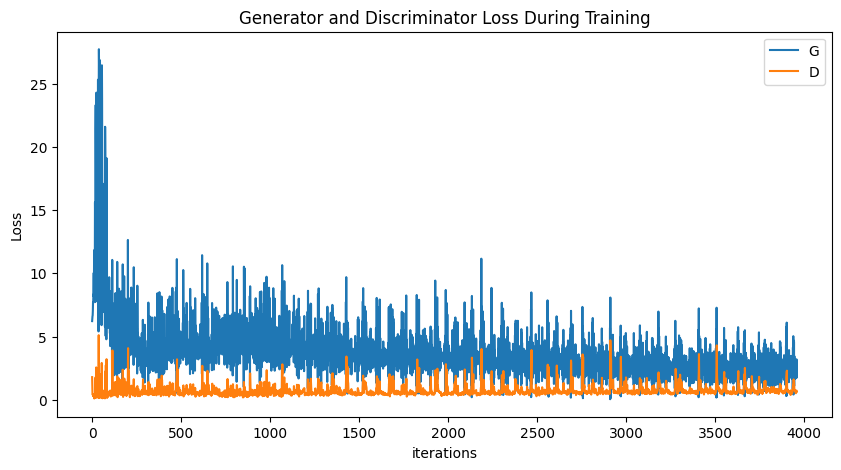

In [56]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
# Сохраняем график в файл PNG
plt.savefig('loss_graph.png', dpi=300) # dpi=300 для высокого разрешения

plt.show()  # Отображаем график после его сохранения

In [ ]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())